<a href="https://colab.research.google.com/github/srimayamohapatra/Crop-Production-in-India-/blob/main/Bi_Temporal_Crop_Health_Monitoring_Framework.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install rasterio numpy scikit-learn matplotlib

✅ File Loaded Successfully!
----------------------------------------
Filename:   KarbiAnglong2021.tif
Dimensions: 9308 (Width) x 6636 (Height)
CRS (Map):  EPSG:32646
Data Type:  uint8
----------------------------------------
Min Value:  0.00
Max Value:  255.00
➡ Interpretation: Unknown scale. Check manually.


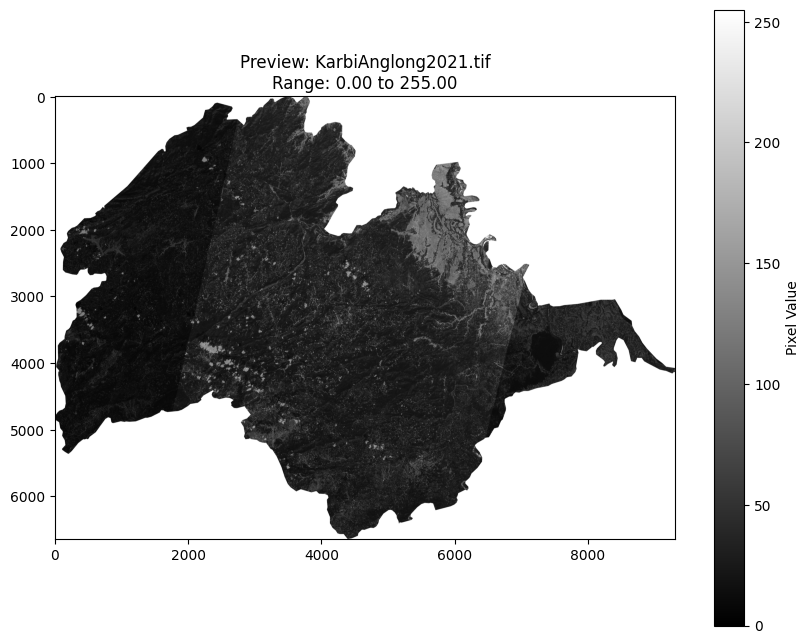

In [ ]:
# ==========================================
# STEP 1: IMPORT LIBRARIES
# ==========================================
import rasterio   # To read the geospatial .tif file
import numpy as np # To handle the pixel numbers
import matplotlib.pyplot as plt # To verify the image visually
import os         # To check if the file exists

# ==========================================
# STEP 2: DEFINE THE PATH
# ==========================================
# Path matches the filename seen in your screenshot
file_path = "/content/KarbiAnglong2021.tif"

# ==========================================
# STEP 3: LOAD AND INSPECT
# ==========================================
if os.path.exists(file_path):
    with rasterio.open(file_path) as src:

        # 1. Read the image data (Band 1)
        data = src.read(1)

        # 2. Get the Metadata (Important for aligning with other maps)
        meta = src.profile

        print("✅ File Loaded Successfully!")
        print("-" * 40)

        # 3. Print Key Information
        print(f"Filename:   KarbiAnglong2021.tif")
        print(f"Dimensions: {src.width} (Width) x {src.height} (Height)")
        print(f"CRS (Map):  {src.crs}")  # Check if this matches your NDVI files later!
        print(f"Data Type:  {meta['dtype']}")

        # 4. Analyze Values (To understand what this file is)
        min_val = np.nanmin(data)
        max_val = np.nanmax(data)
        print("-" * 40)
        print(f"Min Value:  {min_val:.2f}")
        print(f"Max Value:  {max_val:.2f}")

        # 5. Interpretation Logic
        if max_val <= 1.0 and min_val >= -1.0:
            print("➡ Interpretation: This looks like a SPECTRAL INDEX (NDVI, EVI, etc).")
        elif max_val > 1000:
            print("➡ Interpretation: This looks like RAW DATA or Integer format (Needs /10000?).")
        else:
            print("➡ Interpretation: Unknown scale. Check manually.")

        # ==========================================
        # STEP 4: VISUALIZE
        # ==========================================
        plt.figure(figsize=(10, 8))
        # Using 'gray' cmap to see raw details clearly
        plt.imshow(data, cmap='gray')
        plt.title(f"Preview: KarbiAnglong2021.tif\nRange: {min_val:.2f} to {max_val:.2f}")
        plt.colorbar(label="Pixel Value")
        plt.show()

else:
    print(f"❌ Error: File not found at {file_path}")
    print("Please check if the file name is exactly 'KarbiAnglong2021.tif' in the folder.")

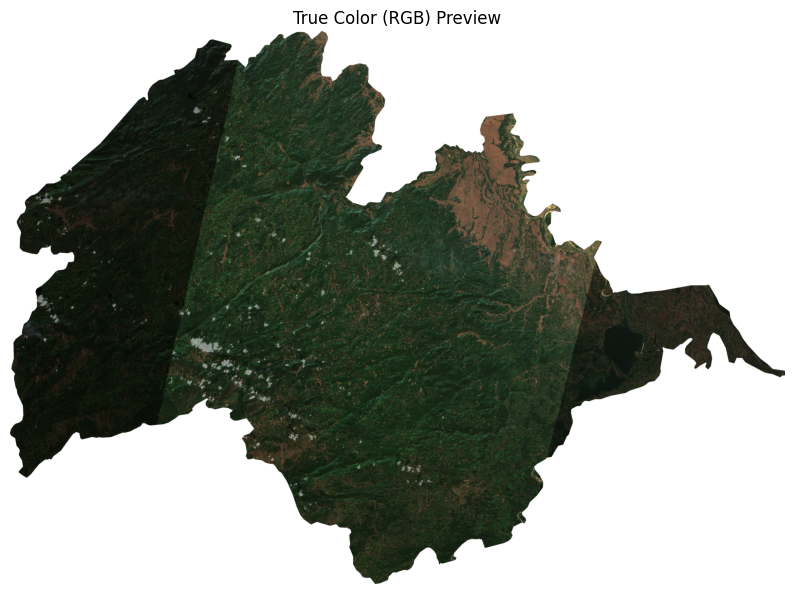

In [ ]:

import rasterio
import numpy as np
import matplotlib.pyplot as plt

file_path = "/content/KarbiAnglong2021.tif"

with rasterio.open(file_path) as src:
    # 1. Check if the file actually has 3 bands (Red, Green, Blue)
    if src.count < 3:
        print(f"⚠️ Warning: This file only has {src.count} band(s). It cannot be displayed as RGB.")
        # If it's 1 band, we just show it in gray
        data = src.read(1)
        plt.imshow(data, cmap='gray')
    else:
        # 2. Read all 3 bands (Assumes Band 1=Red, Band 2=Green, Band 3=Blue)
        # Note: Rasterio reads as (Bands, Height, Width) -> e.g. (3, 500, 500)
        r = src.read(1)
        g = src.read(2)
        b = src.read(3)

        # 3. Stack them into an image format Python likes: (Height, Width, 3)
        rgb_image = np.dstack((r, g, b))

        # 4. Normalize for Display (CRITICAL STEP)
        # Matplotlib expects values between 0.0 and 1.0 (Floats) or 0 and 255 (Integers).
        # Satellite data is often 0 to 10000 or 0 to 65535. We must scale it down.

        if rgb_image.max() > 255:
            # If values are huge (e.g. 3000), divide by a scaling factor to brighten it
            # Adjust '3000' if the image is too dark or too bright
            print(f"Scaling data... (Max value was {rgb_image.max()})")
            rgb_image = rgb_image.astype(float) / 3000.0
            rgb_image = np.clip(rgb_image, 0, 1) # Force values to stay between 0 and 1
        elif rgb_image.dtype != np.uint8:
            # If it's already small floats (0-1), just ensure it's clipped
            rgb_image = np.clip(rgb_image, 0, 1)

        # 5. Plot
        plt.figure(figsize=(10, 10))
        plt.title("True Color (RGB) Preview")
        plt.imshow(rgb_image)
        plt.axis('off')
        plt.show()

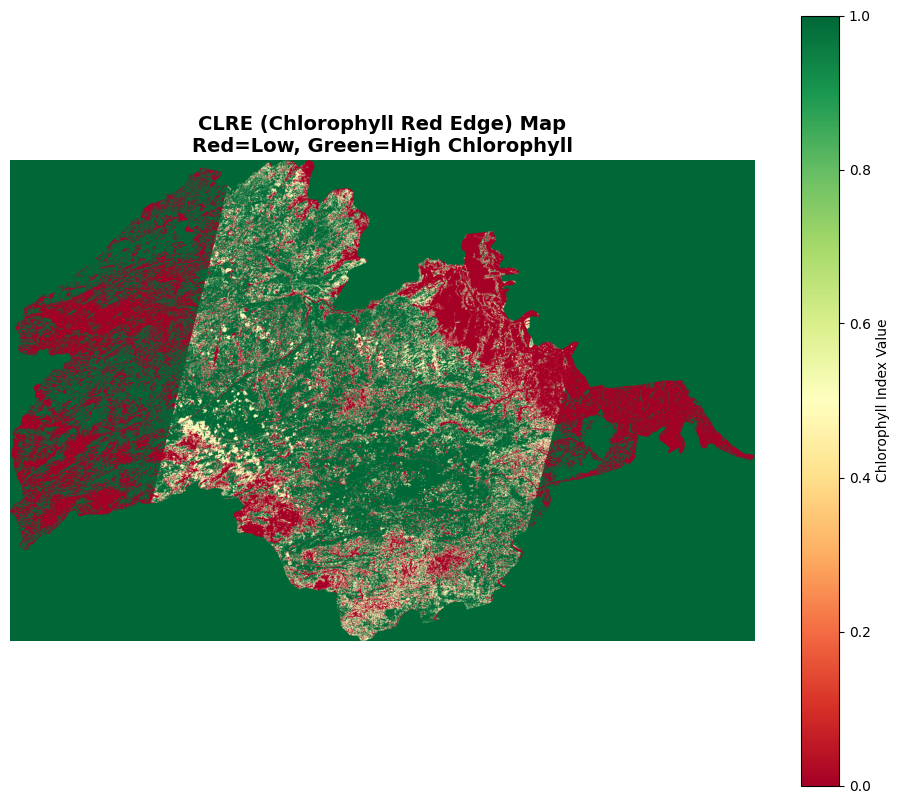

Stats: Min=-1.000, Max=2147483648.000, Mean=1067633600.000


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy # Needed to modify the colormap safely

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/CLRE2021.tif"

# ==========================================
# 2. LOAD & VISUALIZE
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Clean data (Mask NoData and clip extreme outliers)
    data_masked = np.ma.masked_invalid(data)

    # CLRE typically ranges from 0 to 2.0.
    # We clip it to 0-1.5 to make the crop variation visible.
    data_masked = np.clip(data_masked, 0, 1.5)

    # ==========================================
    # 3. PLOT WITH WHITE BACKGROUND
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # 1. FORCE THE FIGURE BACKGROUND TO BE WHITE
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # 2. CUSTOMIZE COLORMAP FOR NODATA VALUES
    # We create a copy of the 'RdYlGn' map so we can change it
    my_cmap = copy.copy(plt.cm.RdYlGn)
    # Tell the map to paint any masked (NoData) pixels WHITE
    my_cmap.set_bad(color='white')

    # Use our custom colormap
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("CLRE (Chlorophyll Red Edge) Map\nRed=Low, Green=High Chlorophyll",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="Chlorophyll Index Value")
    ax.axis('off')

    plt.show()

    # Print stats to verify the range
    print(f"Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}, Mean={np.nanmean(data):.3f}")

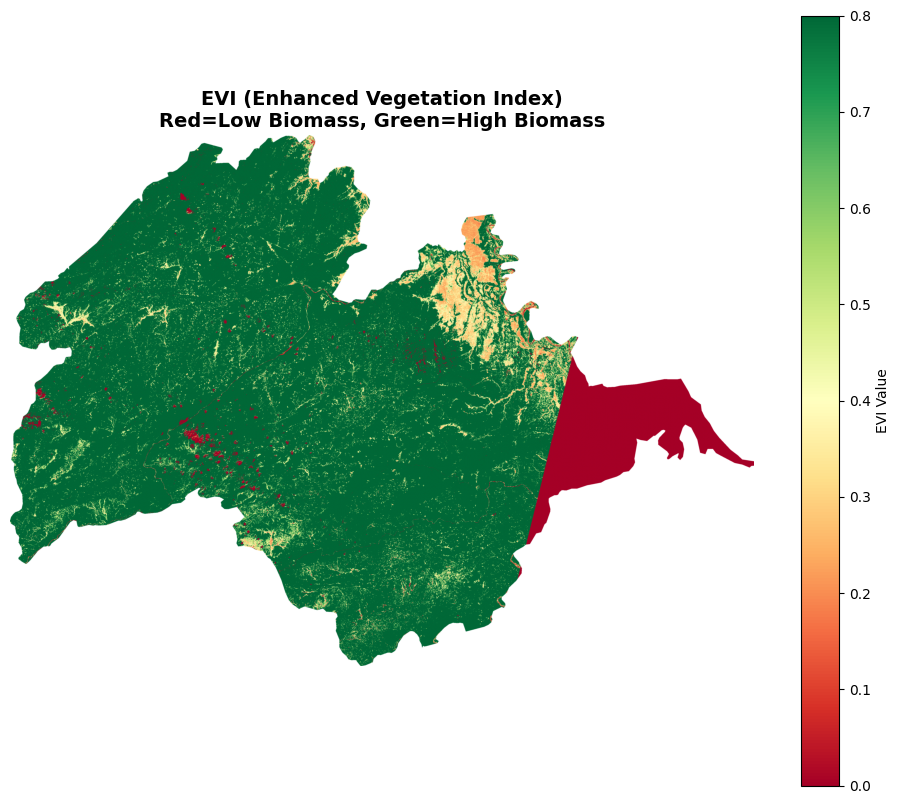

Stats: Min=-inf, Max=5490.000


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
# Note the comma in the filename based on your screenshot
file_path = "/content/EVI,2021.tif"

# ==========================================
# 2. LOAD & VISUALIZE
# ==========================================
if not os.path.exists(file_path):
    print(f"❌ Error: File not found at {file_path}")
else:
    with rasterio.open(file_path) as src:
        data = src.read(1)

        # Clean data (Mask NoData)
        data_masked = np.ma.masked_invalid(data)

        # EVI generally ranges from -1 to 1.
        # Vegetation is usually 0.2 to 0.8.
        # We set the display range from 0 to 0.8 for best contrast.
        data_masked = np.clip(data_masked, -0.2, 1.0)

        # ==========================================
        # 3. PLOT
        # ==========================================
        fig, ax = plt.subplots(figsize=(12, 10))

        # Force background to White
        fig.patch.set_facecolor('white')
        ax.set_facecolor('white')

        # Setup Colormap
        my_cmap = copy.copy(plt.cm.RdYlGn)
        my_cmap.set_bad(color='white') # Make empty pixels white

        # Plot
        im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=0.8)

        ax.set_title("EVI (Enhanced Vegetation Index)\nRed=Low Biomass, Green=High Biomass",
                     fontsize=14, fontweight='bold')

        plt.colorbar(im, ax=ax, label="EVI Value")
        ax.axis('off')

        plt.show()

        # Print stats
        print(f"Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

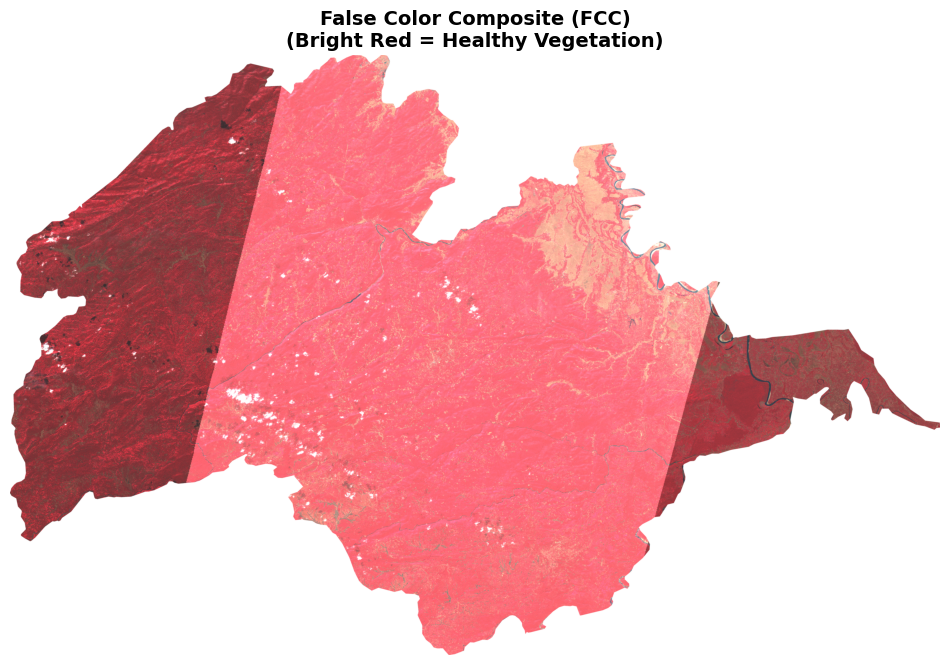

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/FCC,2021.tif"

# ==========================================
# 2. LOAD & PREPARE
# ==========================================
with rasterio.open(file_path) as src:
    # Read the 3 bands (Red, Green, Blue channels of the FCC)
    # Remember: In FCC, Red Channel = NIR (Vegetation)
    r = src.read(1)
    g = src.read(2)
    b = src.read(3)

    # Stack them into an RGB image
    fcc_image = np.dstack((r, g, b))

    # NORMALIZE (Scale to 0-1 for display)
    # Check if values are huge (e.g. 3000) or byte (0-255)
    if fcc_image.max() > 255:
        fcc_image = fcc_image.astype(float) / 3000.0
    elif fcc_image.max() > 1:
        fcc_image = fcc_image.astype(float) / 255.0

    # Clip to ensure no values exceed 1.0 (avoids whiteout)
    fcc_image = np.clip(fcc_image, 0, 1)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Display the image
    ax.imshow(fcc_image)

    # Add Title
    ax.set_title("False Color Composite (FCC)\n(Bright Red = Healthy Vegetation)",
                 fontsize=14, fontweight='bold')

    # Hide Axis
    ax.axis('off')

    plt.show()

Raw Data Stats -> Min: 1955.00, Max: 2147483648.00
⚠ Detected raw integer data. Dividing by 10,000...


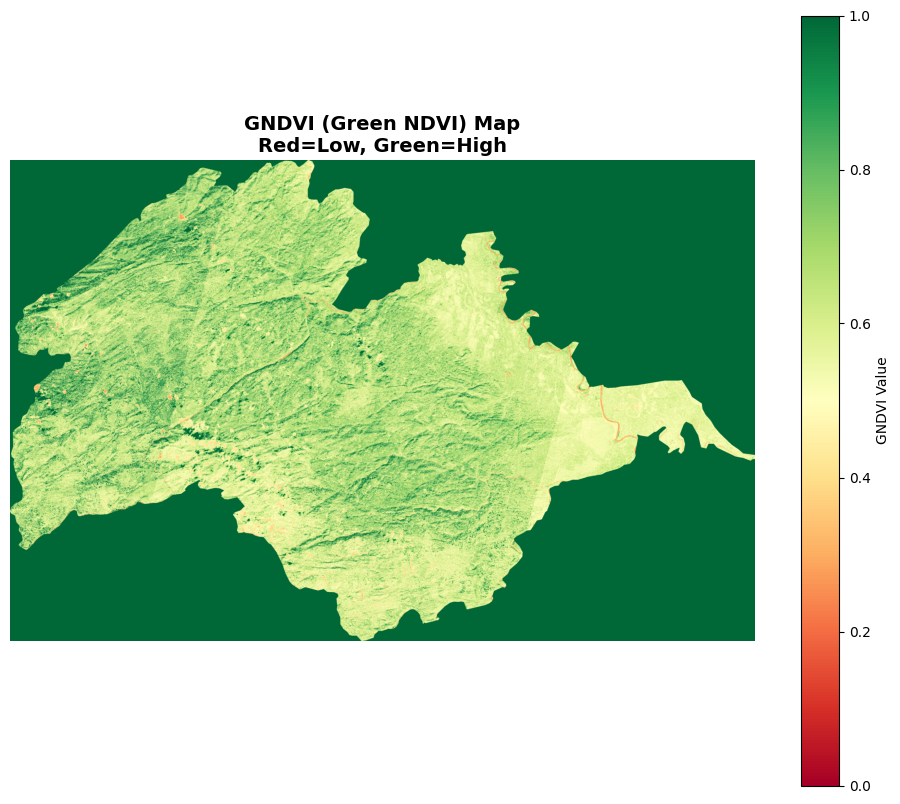

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/GNDVI2021.tif"

# ==========================================
# 2. LOAD & FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Check the raw stats BEFORE we do anything
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: HANDLE NODATA
    # Convert very large negative numbers (like -3.4e+38) to NaN
    data = np.where(data < -100, np.nan, data)

    # FIX 2: HANDLE SCALING
    # If the max value is huge (e.g. > 100), it's likely scaled by 10,000
    if np.nanmax(data) > 100:
        print("⚠ Detected raw integer data. Dividing by 10,000...")
        data = data / 10000.0

    # Mask NaNs so they don't mess up the plot
    data_masked = np.ma.masked_invalid(data)

    # Clip to standard GNDVI range (0 to 1) to remove sparkles/noise
    data_masked = np.clip(data_masked, 0, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force White Background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white')

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("GNDVI (Green NDVI) Map\nRed=Low, Green=High",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="GNDVI Value")
    ax.axis('off')

    plt.show()

Raw Data Stats -> Min: 2230.00, Max: 2147483648.00
⚠ Detected raw integers (e.g. 5000). Scaling down by 10,000...


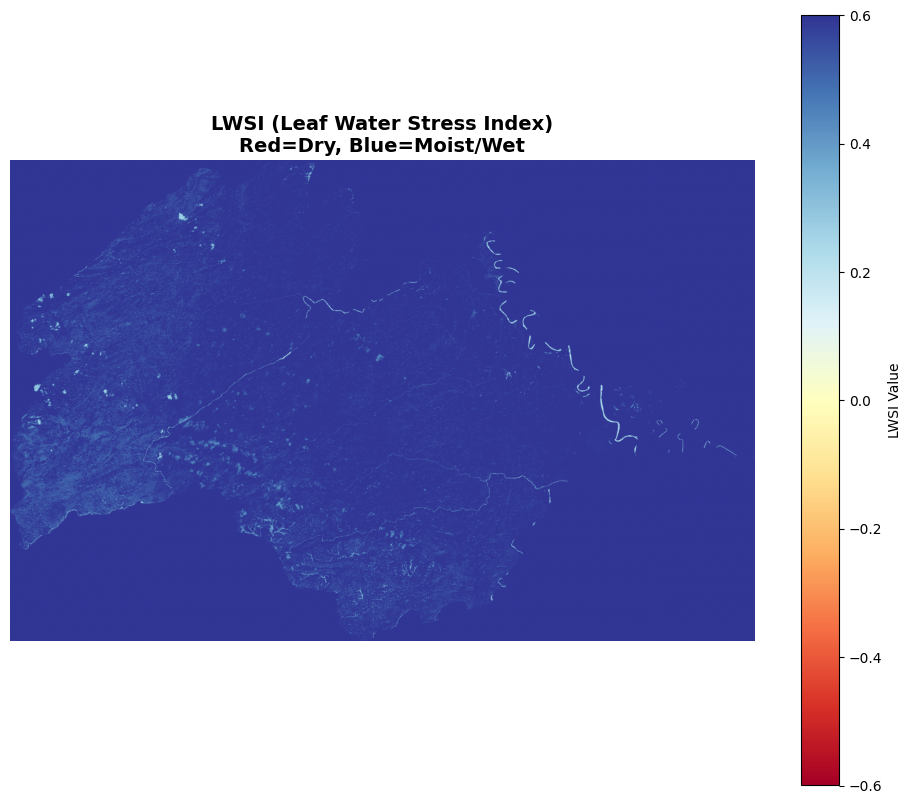

Final Display Stats -> Min: 0.223, Max: 0.600


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/LWSI,2021.tif"

# ==========================================
# 2. LOAD & AUTO-REPAIR DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print raw stats to see what's wrong
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX A: Handle huge NoData values (negative infinity)
    # Convert anything smaller than -100 to NaN
    data = np.where(data < -100, np.nan, data)

    # FIX B: Handle Integer Scaling (e.g. 5000 instead of 0.5)
    # If the max value is > 10, we assume it needs to be divided by 10,000
    if np.nanmax(data) > 10:
        print("⚠ Detected raw integers (e.g. 5000). Scaling down by 10,000...")
        data = data / 10000.0

    # FIX C: Clip outliers to ensure good contrast
    # LWSI usually stays between -0.8 and 0.8.
    # We clip it so one bright pixel doesn't ruin the whole map.
    data_masked = np.ma.masked_invalid(data)
    data_masked = np.clip(data_masked, -0.6, 0.6)

    # ==========================================
    # 3. PLOT WITH WHITE BACKGROUND
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Color Map: Red=Dry, Blue=Wet
    my_cmap = copy.copy(plt.cm.RdYlBu)
    my_cmap.set_bad(color='white') # NoData becomes White

    # Plot with fixed range (-0.6 to 0.6 gives best contrast for LWSI)
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=-0.6, vmax=0.6)

    ax.set_title("LWSI (Leaf Water Stress Index)\nRed=Dry, Blue=Moist/Wet",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="LWSI Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Display Stats -> Min: {np.nanmin(data_masked):.3f}, Max: {np.nanmax(data_masked):.3f}")

📊 RAW STATS -> Min: -433.8000, Max: 3718.8000, Mean: 491.0449
⚠ Data values are huge (>10). Dividing by 10,000 to normalize...
✂ Clipping display range to: 0.0186 - 0.0912


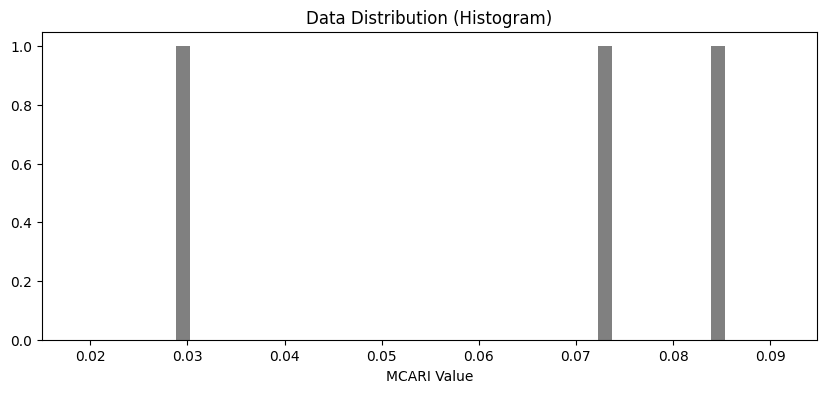

⚖ Using Auto-Threshold: 0.0491


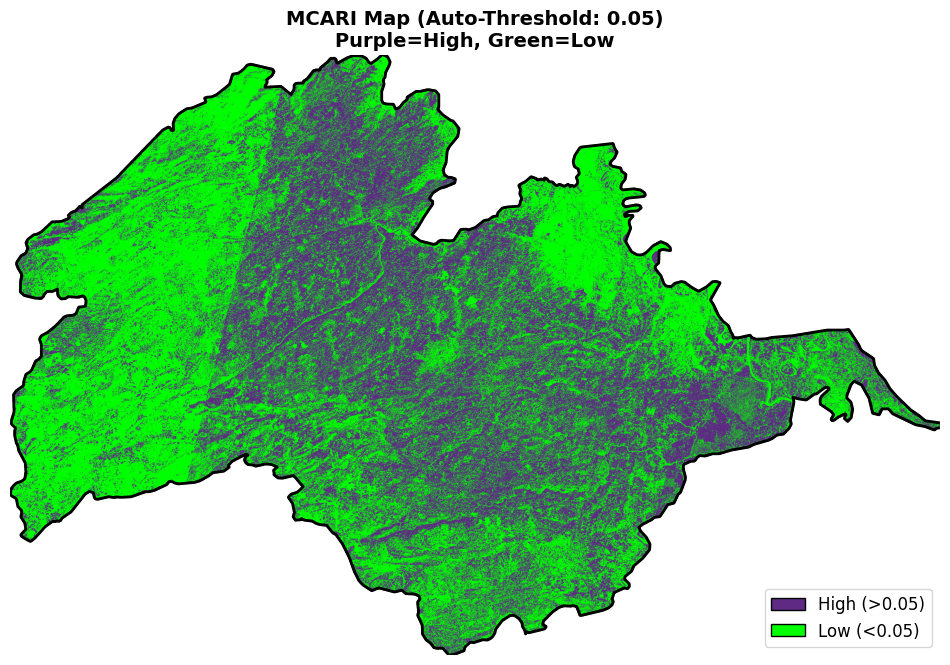

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/MCARI2021.tif"

# ==========================================
# 2. LOAD DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Replace "NoData" values (usually huge negatives) with NaN
    data = np.where(data < -1000, np.nan, data)

    # --------------------------------------
    # DIAGNOSTIC STEP: PRINT RAW STATS
    # --------------------------------------
    valid_data = data[~np.isnan(data)]
    if len(valid_data) == 0:
        print("❌ ERROR: The file seems to be empty or all NoData.")
    else:
        print(f"📊 RAW STATS -> Min: {np.nanmin(data):.4f}, Max: {np.nanmax(data):.4f}, Mean: {np.nanmean(data):.4f}")

        # Check for integer scaling (e.g., 0-10000 range)
        if np.nanmax(data) > 10:
            print("⚠ Data values are huge (>10). Dividing by 10,000 to normalize...")
            data = data / 10000.0

    # --------------------------------------
    # FIX STEP: ROBUST CLIPPING
    # --------------------------------------
    # We clip the data to the 2nd and 98th percentile.
    # This removes random bright pixels that ruin the map.
    vmin, vmax = np.nanpercentile(data, [2, 98])
    print(f"✂ Clipping display range to: {vmin:.4f} - {vmax:.4f}")

    data_clipped = np.clip(data, vmin, vmax)
    data_masked = np.ma.masked_invalid(data_clipped)

    # ==========================================
    # 3. PLOT HISTOGRAM (To understand the data)
    # ==========================================
    fig_hist, ax_hist = plt.subplots(figsize=(10, 4))
    ax_hist.hist(valid_data.flatten(), bins=50, color='gray', range=(vmin, vmax))
    ax_hist.set_title("Data Distribution (Histogram)")
    ax_hist.set_xlabel("MCARI Value")
    plt.show()

    # ==========================================
    # 4. PLOT THE MAP (Purple/Green)
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Define Colors: Green (Low) -> Purple (High)
    colors = ['#00ff00', '#5e2a84']
    cmap_custom = mcolors.ListedColormap(colors)
    cmap_custom.set_bad(color='white')

    # Define Threshold
    # We set the threshold to the MEAN value automatically.
    # This ensures roughly half the map is Green and half is Purple.
    auto_threshold = np.nanmean(data)
    print(f"⚖ Using Auto-Threshold: {auto_threshold:.4f}")

    bounds = [vmin, auto_threshold, vmax]
    norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

    # Plot
    im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

    # Border
    mask_valid = (~np.ma.getmask(data_masked)).astype(int)
    if np.any(mask_valid):
        ax.contour(mask_valid, levels=[0.5], colors='black', linewidths=2)

    ax.set_title(f"MCARI Map (Auto-Threshold: {auto_threshold:.2f})\nPurple=High, Green=Low",
                 fontsize=14, fontweight='bold')
    ax.axis('off')

    # Legend
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor=colors[1], edgecolor='black', label=f'High (>{auto_threshold:.2f})'),
        Patch(facecolor=colors[0], edgecolor='black', label=f'Low (<{auto_threshold:.2f})')
    ]
    ax.legend(handles=legend_elements, loc='lower right', fontsize=12)

    plt.show()

📊 RAW STATS -> Min: 0.00, Max: 65536.00
⚠ Detected large integers. Dividing by 10,000...
⚖ Calculated Auto-Threshold: 0.000


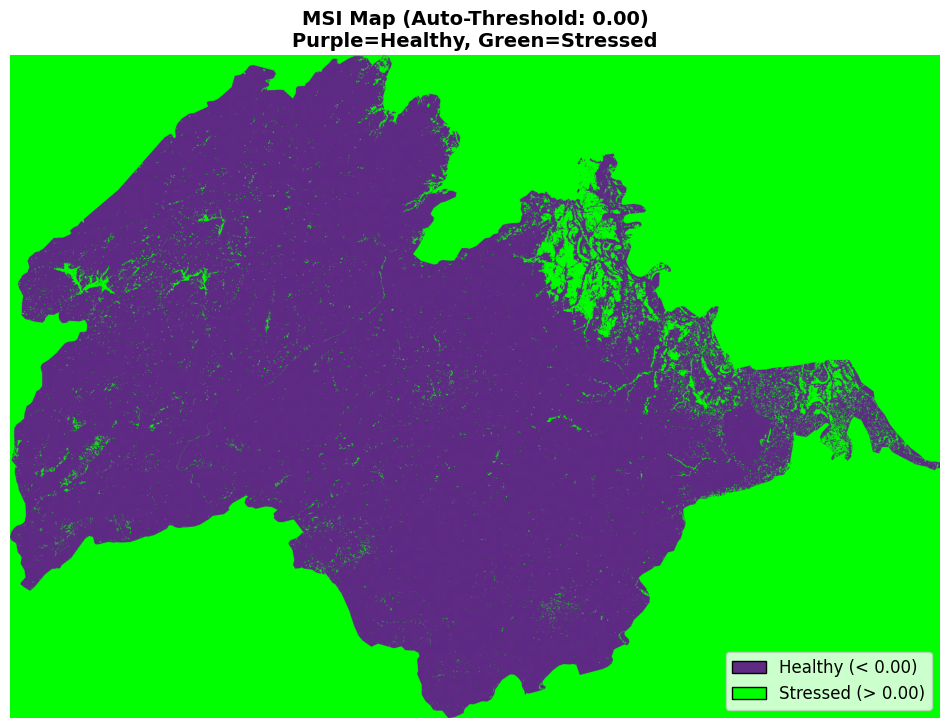

In [2]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/MSI,2021.tif"

# ==========================================
# 2. LOAD & DIAGNOSE DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Replace NoData (huge negatives) with NaN
    data = np.where(data < -100, np.nan, data)

    # --------------------------------------
    # STEP A: CHECK RAW STATS
    # --------------------------------------
    valid_pixels = data[~np.isnan(data)]
    if len(valid_pixels) == 0:
        print("❌ ERROR: File is empty or all NoData.")
    else:
        raw_max = np.nanmax(data)
        print(f"📊 RAW STATS -> Min: {np.nanmin(data):.2f}, Max: {raw_max:.2f}")

        # --------------------------------------
        # STEP B: AUTO-FIX SCALING
        # --------------------------------------
        # If max value is > 10, it's likely 0-10000 scale. We fix it.
        if raw_max > 10:
            print("⚠ Detected large integers. Dividing by 10,000...")
            data = data / 10000.0

        # Clip strictly to 0-4 range (MSI rarely goes higher) to remove glitches
        data = np.clip(data, 0, 4.0)
        data_masked = np.ma.masked_invalid(data)

        # --------------------------------------
        # STEP C: AUTO-CALCULATE THRESHOLD
        # --------------------------------------
        # We set the split point at the MEDIAN value.
        # This guarantees roughly 50% Purple and 50% Green.
        auto_threshold = np.nanmedian(data)
        print(f"⚖ Calculated Auto-Threshold: {auto_threshold:.3f}")

        # ==========================================
        # 3. PLOT MAP
        # ==========================================
        fig, ax = plt.subplots(figsize=(12, 10))

        # Force White Background
        fig.patch.set_facecolor('white')
        ax.set_facecolor('white')

        # Define Colors: Purple (Healthy/Low) -> Green (Stressed/High)
        colors = ['#5e2a84', '#00ff00']
        cmap_custom = mcolors.ListedColormap(colors)
        cmap_custom.set_bad(color='white')

        # Create Norm based on Auto-Threshold
        # 0 to Threshold -> Purple
        # Threshold to 4.0 -> Green
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

        # Plot
        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Add Border
        mask_valid = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask_valid):
            ax.contour(mask_valid, levels=[0.5], colors='black', linewidths=2)

        # Title & Legend
        ax.set_title(f"MSI Map (Auto-Threshold: {auto_threshold:.2f})\nPurple=Healthy, Green=Stressed",
                     fontsize=14, fontweight='bold')

        from matplotlib.patches import Patch
        legend_elements = [
            Patch(facecolor=colors[0], edgecolor='black', label=f'Healthy (< {auto_threshold:.2f})'),
            Patch(facecolor=colors[1], edgecolor='black', label=f'Stressed (> {auto_threshold:.2f})')
        ]
        ax.legend(handles=legend_elements, loc='lower right', fontsize=12)

        ax.axis('off')
        plt.show()

Raw Data Stats -> Min: 1267.50, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


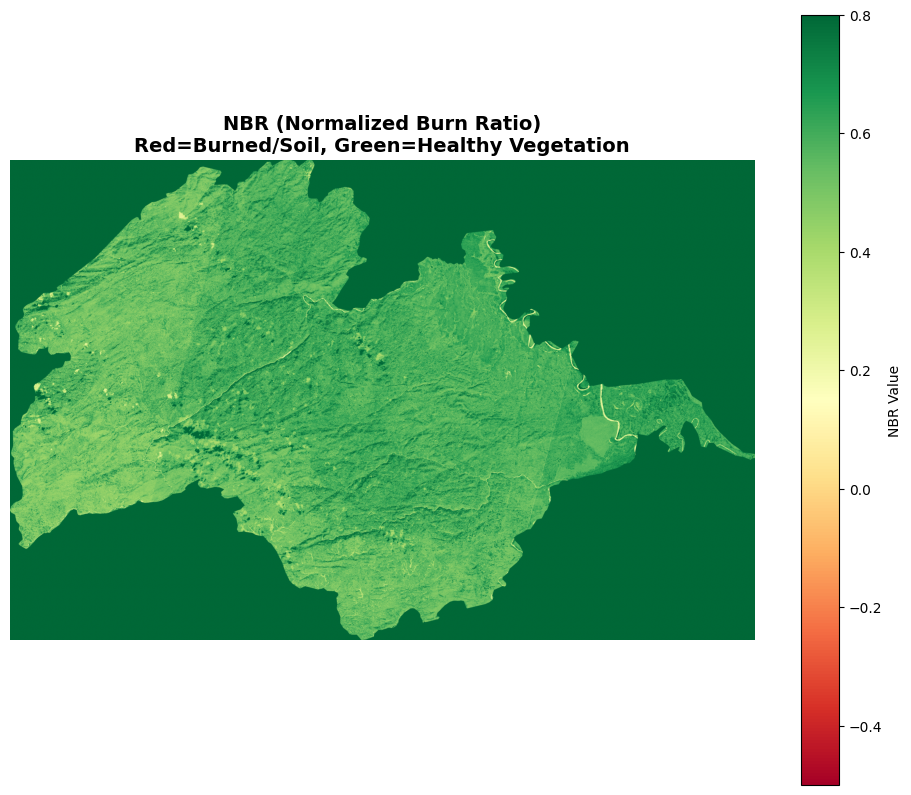

Final Stats: Min=0.127, Max=214748.359


In [3]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/NBR,2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for scaling issues
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integer scaling (e.g. 5000 instead of 0.5)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData (Mask out infinite or huge negative numbers)
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # Clip range for better contrast
    # NBR usually ranges from -1 to 1.
    # We focus on -0.5 (Burned/Water) to 0.8 (Healthy Veg)
    data_masked = np.clip(data_masked, -0.5, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Burned/Soil) -> Green (Healthy Vegetation)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=-0.5, vmax=0.8)

    ax.set_title("NBR (Normalized Burn Ratio)\nRed=Burned/Soil, Green=Healthy Vegetation",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NBR Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

Raw Data Stats -> Min: 2109.00, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


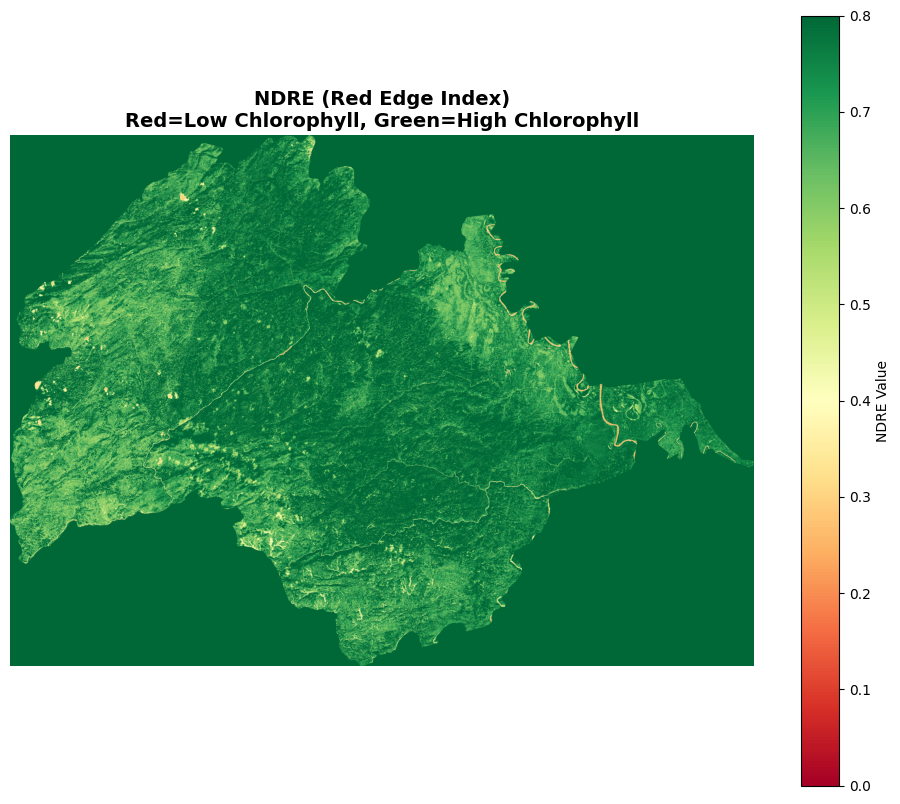

Final Stats: Min=0.211, Max=214748.359


In [4]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/NDRE2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for integer scaling
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integers (e.g. 7000 instead of 0.7)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # NDRE Range: -1 to 1
    # We clip to 0.0 - 0.8 to highlight crop variation.
    data_masked = np.clip(data_masked, 0.0, 0.8)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Soil/Stress) -> Green (Healthy/Dense)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=0.8)

    ax.set_title("NDRE (Red Edge Index)\nRed=Low Chlorophyll, Green=High Chlorophyll",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NDRE Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

Raw Data Stats -> Min: 1753.50, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


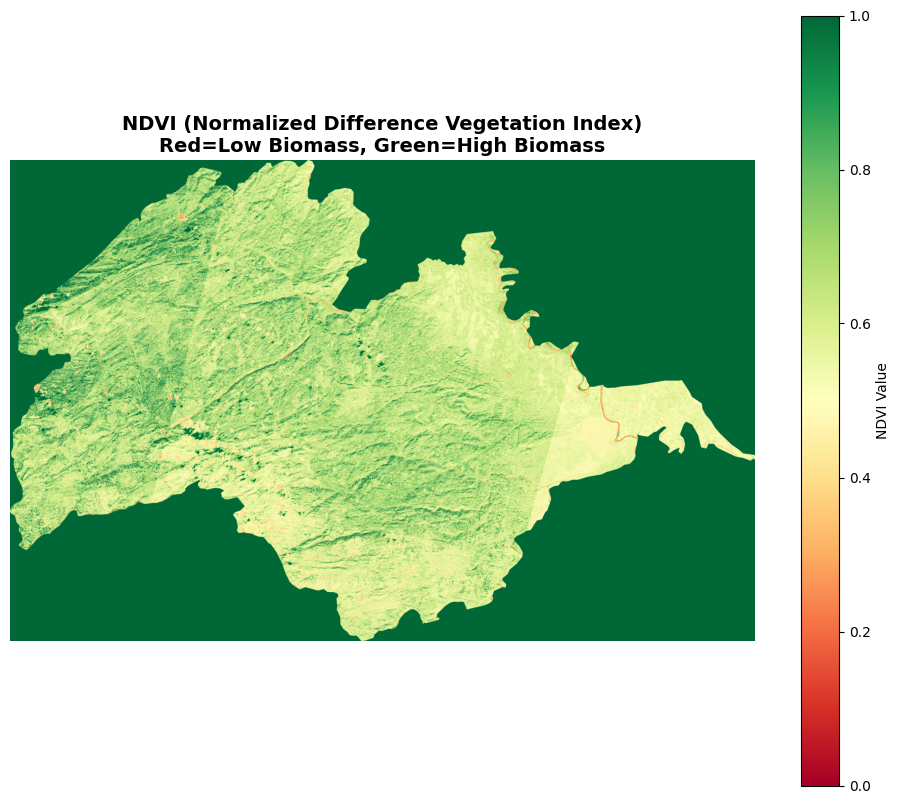

Final Stats: Min=0.175, Max=214748.359


In [5]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
# Note: Ensure the comma is correct in the filename based on your list
file_path = "/content/NDVI,2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for integer scaling
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integers (e.g. 8000 instead of 0.8)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData (Mask out infinite or huge negative numbers)
    # Convert values < -100 to NaN
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # NDVI Standard Range: -1 to 1
    # We clip to 0.0 to 1.0 to focus on Vegetation vs. Soil
    data_masked = np.clip(data_masked, 0.0, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Soil) -> Green (Healthy Veg)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("NDVI (Normalized Difference Vegetation Index)\nRed=Low Biomass, Green=High Biomass",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NDVI Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

In [2]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject, calculate_default_transform
import numpy as np
import os

# ==========================================
# STEP 1: DEFINE FILES & MASTER REFERENCE
# ==========================================
# We use NDVI as the "Master" because it loaded successfully
master_path = "/content/NDVI,2021.tif"

file_paths = {
    # The files we need to fix
    "NDVI":  "/content/NDVI,2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "NDRE":  "/content/NDRE2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "MSI":   "/content/MSI,2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "Ref_Karbi": "/content/KarbiAnglong2021.tif"
}

# ==========================================
# STEP 2: ALIGNMENT & CLEANING FUNCTION
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}

    # 1. Read the Reference Metadata (The "Truth")
    with rasterio.open(reference_path) as ref_src:
        ref_meta = ref_src.profile
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 MASTER REFERENCE: NDVI | Shape: {ref_shape}")
        print("-" * 60)

    # 2. Loop through all files
    for name, path in files.items():
        if not os.path.exists(path):
            continue

        with rasterio.open(path) as src:
            data = src.read(1)

            # CHECK 1: RESAMPLING (Fixing the Size)
            # If shape doesn't match Master, we reproject it
            if src.shape != ref_shape:
                print(f"🔧 Resizing {name:<6} from {src.shape} to {ref_shape}...")

                # Create empty array of the correct (Master) size
                new_data = np.zeros(ref_shape, dtype=np.float32)

                reproject(
                    source=rasterio.band(src, 1),
                    destination=new_data,
                    src_transform=src.transform,
                    src_crs=src.crs,
                    dst_transform=ref_transform,
                    dst_crs=ref_crs,
                    resampling=Resampling.bilinear
                )
                data = new_data # Update data to the new resized version
            else:
                # Even if size matches, ensure it's float32
                data = data.astype(np.float32)

            # CHECK 2: CLEANING (Fixing the Huge Numbers)
            # If values are huge (NoData markers), turn them into NaN
            # Also fix the scaling if needed (divide by 10000)

            # First, check if it needs scaling (e.g., raw integer 1373)
            # We check the 99th percentile to avoid outliers throwing us off
            max_val = np.nanmax(data)

            if max_val > 100000: # This catches the 214748 NoData error
                # Mask out the specific NoData value (usually > 200000)
                data[data > 10000] = np.nan

            # Now check if we still have raw integers (e.g. 3000 instead of 0.3)
            current_max = np.nanmax(data)
            if current_max > 100 and name != "Ref_Karbi":
                # Ref_Karbi might be raw bands (0-10000), but indices should be -1 to 1
                data = data / 10000.0

            # Final Cleanup: Remove -inf or inf
            data[np.isinf(data)] = np.nan

            # Store it
            aligned_data[name] = data

            # Print Final Stats
            valid_min = np.nanmin(data)
            valid_max = np.nanmax(data)
            print(f"✅ Ready:  {name:<6} | Range: {valid_min:.2f} to {valid_max:.2f}")

    return aligned_data

# ==========================================
# STEP 3: RUN
# ==========================================
print("Starting Alignment Process (This might take 30 seconds)...")
final_dataset = align_and_load(file_paths, master_path)

print("\n🎉 Alignment Complete!")
print(f"You now have {len(final_dataset)} images, all size {final_dataset['NDVI'].shape}.")

Starting Alignment Process (This might take 30 seconds)...
🎯 MASTER REFERENCE: NDVI | Shape: (3144, 4871)
------------------------------------------------------------
✅ Ready:  NDVI   | Range: 0.18 to 1.00
🔧 Resizing EVI    from (3317, 4653) to (3144, 4871)...
✅ Ready:  EVI    | Range: -0.42 to 0.32
🔧 Resizing NDRE   from (3317, 4653) to (3144, 4871)...
✅ Ready:  NDRE   | Range: 0.22 to 1.00
✅ Ready:  GNDVI  | Range: 0.20 to 1.00
✅ Ready:  CLRE   | Range: -1.00 to 2.50
✅ Ready:  MCARI  | Range: -0.04 to 0.37
✅ Ready:  LWSI   | Range: 0.22 to 1.00
✅ Ready:  NDWI   | Range: 0.16 to 1.00
🔧 Resizing MSI    from (3317, 4653) to (3144, 4871)...
✅ Ready:  MSI    | Range: 0.00 to 6.55
✅ Ready:  NBR    | Range: 0.13 to 1.00
🔧 Resizing Ref_Karbi from (6636, 9308) to (3144, 4871)...
✅ Ready:  Ref_Karbi | Range: 0.00 to 255.00

🎉 Alignment Complete!
You now have 11 images, all size (3144, 4871).


⏳ Processing Images...
🎯 Master Shape (NDVI): (3144, 4871)
✅ Loaded: NDVI     | Range: 0.18 to 3.54
✅ Loaded: GNDVI    | Range: 0.20 to 3.54
✅ Loaded: EVI      | Range: -0.42 to 0.32
✅ Loaded: CLRE     | Range: -0.00 to 0.00
✅ Loaded: NBR      | Range: 0.13 to 3.38
✅ Loaded: NDWI     | Range: 0.16 to 3.72
✅ Loaded: LWSI     | Range: 0.22 to 3.30
✅ Loaded: MSI      | Range: 0.00 to 6.55
✅ Loaded: MCARI    | Range: -0.04 to 0.37
✅ Loaded: NDRE     | Range: 0.22 to 3.36
✅ Loaded: Ref_Gray | Range: 0.00 to 255.00

🎨 Generating 12-Panel Grid...


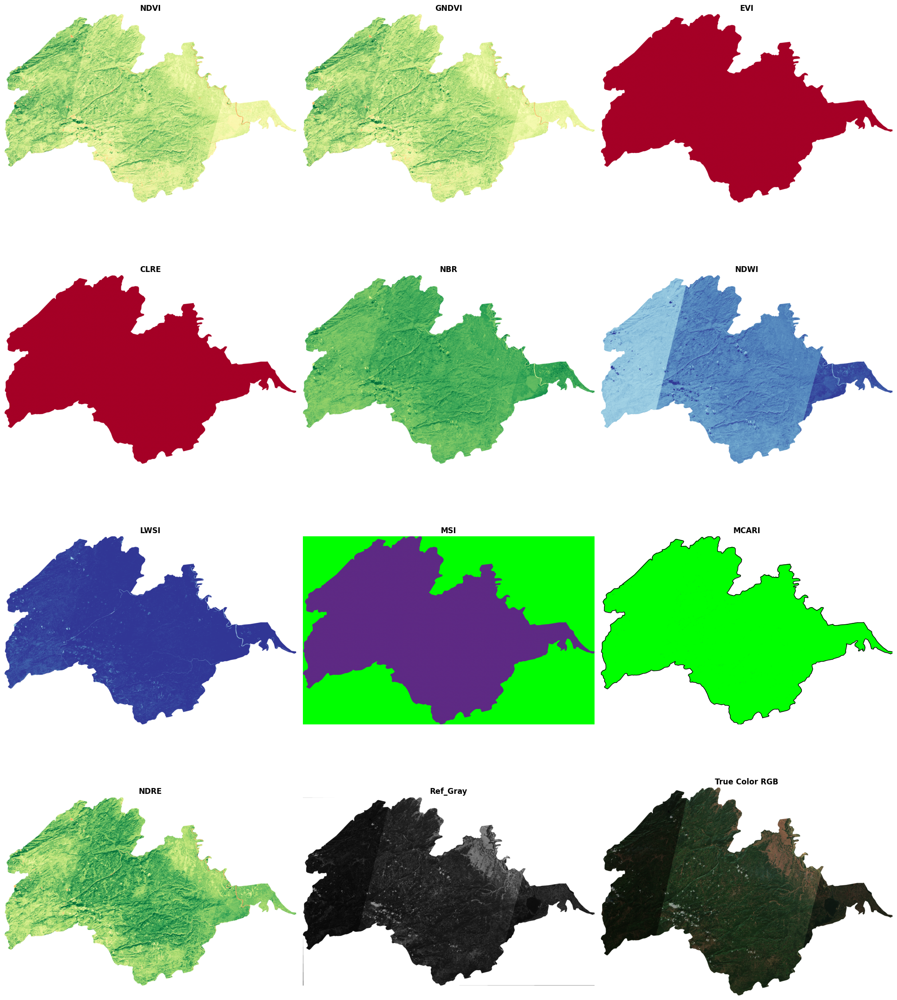

In [5]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import os

# ==========================================
# 1. SETUP FILE PATHS
# ==========================================
# Master Reference (The file we trust for size/shape)
master_path = "/content/NDVI,2021.tif"

# List of Single-Band Indices to Align
index_files = {
    "NDVI":  "/content/NDVI,2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "MSI":   "/content/MSI,2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "NDRE":  "/content/NDRE2021.tif",
    "Ref_Gray": "/content/KarbiAnglong2021.tif" # Used for alignment check only
}

# Path for the True Color Image (RGB)
rgb_path = "/content/KarbiAnglong2021.tif"

# ==========================================
# 2. ALIGNMENT FUNCTION (Creates final_dataset)
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}

    # Open Reference to get Target Shape
    if not os.path.exists(reference_path):
        print("❌ CRITICAL ERROR: Master reference file missing!")
        return {}

    with rasterio.open(reference_path) as ref_src:
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 Master Shape (NDVI): {ref_shape}")

    # Process each file
    for name, path in files.items():
        if not os.path.exists(path):
            print(f"⚠️ Missing: {name}")
            continue

        with rasterio.open(path) as src:
            data = src.read(1) # Read 1st band for indices

            # RESIZE IF NEEDED
            if src.shape != ref_shape:
                # print(f"🔧 Resizing {name}...") # Uncomment to see resize logs
                new_data = np.zeros(ref_shape, dtype=np.float32)
                reproject(
                    source=rasterio.band(src, 1),
                    destination=new_data,
                    src_transform=src.transform,
                    src_crs=src.crs,
                    dst_transform=ref_transform,
                    dst_crs=ref_crs,
                    resampling=Resampling.bilinear
                )
                data = new_data
            else:
                data = data.astype(np.float32)

            # CLEAN DATA (Fix huge numbers)
            # If max > 100, divide by 10,000 (Sentinel scaling)
            if np.nanmax(data) > 100 and name != "Ref_Gray":
                data = data / 10000.0

            # Fix NoData (huge negatives or infinity)
            data = np.where((data < -100) | (data > 10000), np.nan, data)

            aligned_data[name] = data
            print(f"✅ Loaded: {name:<8} | Range: {np.nanmin(data):.2f} to {np.nanmax(data):.2f}")

    return aligned_data

# ==========================================
# 3. EXECUTE ALIGNMENT
# ==========================================
print("⏳ Processing Images...")
final_dataset = align_and_load(index_files, master_path)

# ==========================================
# 4. VISUALIZATION (PLOTTING)
# ==========================================
print("\n🎨 Generating 12-Panel Grid...")
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()
fig.patch.set_facecolor('white')

# ORDER OF PLOTS (Indices only)
plot_order = ["NDVI", "GNDVI", "EVI", "CLRE", "NBR", "NDWI",
              "LWSI", "MSI", "MCARI", "NDRE", "Ref_Gray"]

# A. PLOT THE INDICES (First 11 Panels)
for i, name in enumerate(plot_order):
    ax = axes[i]
    ax.set_facecolor('white')

    if name not in final_dataset:
        ax.text(0.5, 0.5, "Missing", ha='center', color='red')
        ax.set_title(name)
        ax.axis('off')
        continue

    data = final_dataset[name]
    data_masked = np.ma.masked_invalid(data)

    # Styling Logic
    cmap, norm, vmin, vmax = None, None, None, None

    # STRESS (Purple/Green)
    if name in ["MSI", "MCARI"]:
        if name == "MSI":
            colors = ['#5e2a84', '#00ff00'] # Purple->Green
            bounds = [0, 1.0, 5]
        else:
            colors = ['#00ff00', '#5e2a84'] # Green->Purple
            bounds = [-1, 0.15, 1]

        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

    # WATER (Blue/Red)
    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6

    # GRAYSCALE REFERENCE
    elif name == "Ref_Gray":
        cmap = 'gray'
        vmin, vmax = None, None

    # VEGETATION (Red/Green)
    else:
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        if name == "EVI": vmin, vmax = 0, 0.8
        elif name == "CLRE": vmin, vmax = 0, 1.5
        elif name == "NBR": vmin, vmax = -0.5, 0.8
        else: vmin, vmax = 0, 1.0

    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(name, fontweight='bold', fontsize=12)

    # Add Contour
    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask): ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# B. PLOT THE 12TH PANEL (TRUE COLOR RGB)
ax_rgb = axes[11]
ax_rgb.set_facecolor('white')

if os.path.exists(rgb_path):
    with rasterio.open(rgb_path) as src:
        if src.count >= 3:
            r, g, b = src.read(1), src.read(2), src.read(3)
            rgb = np.dstack((r, g, b)).astype(float)

            # Auto-Brightness
            if np.nanmax(rgb) > 255: rgb /= 3000.0 # Sentinel
            elif np.nanmax(rgb) > 1: rgb /= 255.0   # Byte

            rgb = np.clip(rgb, 0, 1)
            ax_rgb.imshow(rgb)
            ax_rgb.set_title("True Color RGB", fontweight='bold', fontsize=12)
        else:
            ax_rgb.text(0.5, 0.5, "Not RGB (1 Band)", ha='center')
else:
    ax_rgb.text(0.5, 0.5, "File Missing", ha='center', color='red')

ax_rgb.axis('off')

plt.tight_layout()
plt.show()

⏳ Processing Images...
🎯 Master Shape: (3144, 4871)
✅ Loaded: NDVI    
✅ Loaded: GNDVI   
✅ Loaded: EVI     
✅ Loaded: CLRE    
✅ Loaded: NBR     
✅ Loaded: NDWI    
✅ Loaded: LWSI    
✅ Loaded: MSI     
✅ Loaded: MCARI   
✅ Loaded: NDRE    
✅ Loaded: Ref_Gray

🎨 Generating 12-Panel Grid...


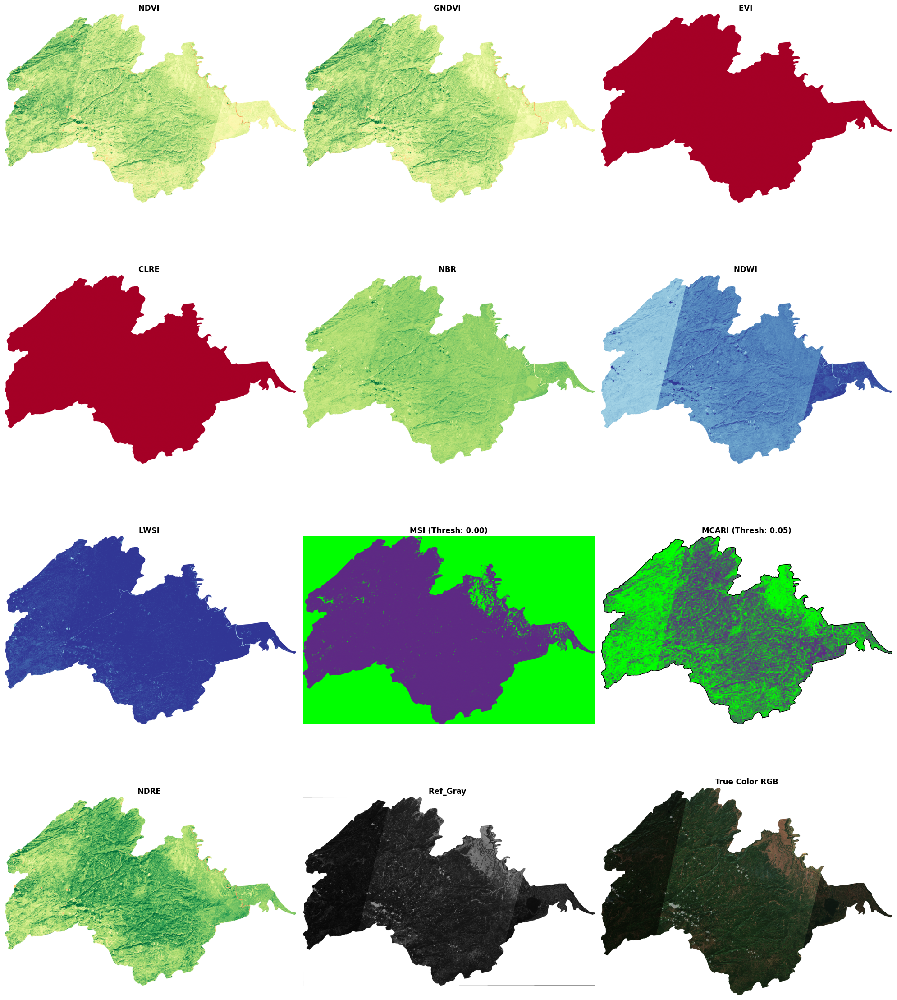

In [1]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import os

# ==========================================
# 1. SETUP FILE PATHS
# ==========================================
master_path = "/content/NDVI,2021.tif"

index_files = {
    "NDVI":  "/content/NDVI,2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "MSI":   "/content/MSI,2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "NDRE":  "/content/NDRE2021.tif",
    "Ref_Gray": "/content/KarbiAnglong2021.tif"
}

rgb_path = "/content/KarbiAnglong2021.tif"

# ==========================================
# 2. ALIGNMENT FUNCTION
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}
    if not os.path.exists(reference_path):
        print("❌ CRITICAL ERROR: Master reference file missing!")
        return {}

    with rasterio.open(reference_path) as ref_src:
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 Master Shape: {ref_shape}")

    for name, path in files.items():
        if not os.path.exists(path):
            print(f"⚠️ Missing: {name}")
            continue

        with rasterio.open(path) as src:
            data = src.read(1)
            # Resize
            if src.shape != ref_shape:
                new_data = np.zeros(ref_shape, dtype=np.float32)
                reproject(source=rasterio.band(src, 1), destination=new_data,
                          src_transform=src.transform, src_crs=src.crs,
                          dst_transform=ref_transform, dst_crs=ref_crs,
                          resampling=Resampling.bilinear)
                data = new_data
            else:
                data = data.astype(np.float32)

            # Fix Scaling (if > 100, divide by 10000)
            if np.nanmax(data) > 100 and name != "Ref_Gray":
                data = data / 10000.0

            # Fix NoData
            data = np.where((data < -100) | (data > 10000), np.nan, data)
            aligned_data[name] = data
            print(f"✅ Loaded: {name:<8}")

    return aligned_data

# ==========================================
# 3. EXECUTE LOADING
# ==========================================
print("⏳ Processing Images...")
final_dataset = align_and_load(index_files, master_path)

# ==========================================
# 4. VISUALIZATION (With Specific Fixes)
# ==========================================
print("\n🎨 Generating 12-Panel Grid...")
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()
fig.patch.set_facecolor('white')

plot_order = ["NDVI", "GNDVI", "EVI", "CLRE", "NBR", "NDWI",
              "LWSI", "MSI", "MCARI", "NDRE", "Ref_Gray"]

for i, name in enumerate(plot_order):
    ax = axes[i]
    ax.set_facecolor('white')

    if name not in final_dataset:
        ax.text(0.5, 0.5, "Missing", ha='center', color='red')
        ax.axis('off'); continue

    data = final_dataset[name]

    # Defaults
    cmap, norm, vmin, vmax = None, None, None, None
    data_plot = data # We might modify this for specific plots

    # ---------------------------------------------------------
    # SPECIAL LOGIC: MSI (Auto-Threshold + Purple/Green)
    # ---------------------------------------------------------
    if name == "MSI":
        # Clip to safe range 0-4
        data_plot = np.clip(data, 0, 4.0)
        auto_threshold = np.nanmedian(data_plot) # Auto-Calc Median

        colors = ['#5e2a84', '#00ff00'] # Purple (Healthy) -> Green (Stressed)
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        title_extra = f"(Thresh: {auto_threshold:.2f})"

    # ---------------------------------------------------------
    # SPECIAL LOGIC: MCARI (Percentile Clip + Green/Purple)
    # ---------------------------------------------------------
    elif name == "MCARI":
        # Robust clipping to remove noise
        p2, p98 = np.nanpercentile(data, [2, 98])
        data_plot = np.clip(data, p2, p98)
        auto_threshold = np.nanmean(data_plot) # Auto-Calc Mean

        colors = ['#00ff00', '#5e2a84'] # Green (Low) -> Purple (High)
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [p2, auto_threshold, p98]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        title_extra = f"(Thresh: {auto_threshold:.2f})"

    # ---------------------------------------------------------
    # SPECIAL LOGIC: EVI (Specific Range)
    # ---------------------------------------------------------
    elif name == "EVI":
        data_plot = np.clip(data, -0.2, 1.0) # Specific Clip
        vmin, vmax = 0, 0.8
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = ""

    # ---------------------------------------------------------
    # SPECIAL LOGIC: CLRE (Specific Range)
    # ---------------------------------------------------------
    elif name == "CLRE":
        data_plot = np.clip(data, 0, 1.5) # Specific Clip
        vmin, vmax = 0, 1.0
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = ""

    # ---------------------------------------------------------
    # STANDARD LOGIC (Everything Else)
    # ---------------------------------------------------------
    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6
        title_extra = ""
    elif name == "Ref_Gray":
        cmap = 'gray'
        title_extra = ""
    else: # NDVI, GNDVI, NBR, NDRE
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        vmin, vmax = -0.5 if name == "NBR" else 0, 1.0
        title_extra = ""

    # PLOT
    data_masked = np.ma.masked_invalid(data_plot)
    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(f"{name} {title_extra}", fontweight='bold', fontsize=12)

    # Add Contour for MSI/MCARI
    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask): ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# ---------------------------------------------------------
# 12TH PANEL: TRUE COLOR RGB
# ---------------------------------------------------------
ax_rgb = axes[11]
ax_rgb.set_facecolor('white')

if os.path.exists(rgb_path):
    with rasterio.open(rgb_path) as src:
        if src.count >= 3:
            r, g, b = src.read(1), src.read(2), src.read(3)
            rgb = np.dstack((r, g, b)).astype(float)

            # Auto-Brightness
            if np.nanmax(rgb) > 255: rgb /= 3000.0
            elif np.nanmax(rgb) > 1: rgb /= 255.0

            rgb = np.clip(rgb, 0, 1)
            ax_rgb.imshow(rgb)
            ax_rgb.set_title("True Color RGB", fontweight='bold', fontsize=12)
        else:
            ax_rgb.text(0.5, 0.5, "Not RGB", ha='center')
else:
    ax_rgb.text(0.5, 0.5, "File Missing", ha='center', color='red')

ax_rgb.axis('off')

plt.tight_layout()
plt.show()

⏳ Processing Images...
🎯 Master Shape: (3144, 4871)
✅ Loaded: NDVI    
✅ Loaded: GNDVI   
✅ Loaded: EVI     
✅ Loaded: CLRE    
✅ Loaded: NBR     
✅ Loaded: NDWI    
✅ Loaded: LWSI    
✅ Loaded: MSI     
✅ Loaded: MCARI   
✅ Loaded: NDRE    
✅ Loaded: Ref_Gray

🎨 Generating 12-Panel Grid...


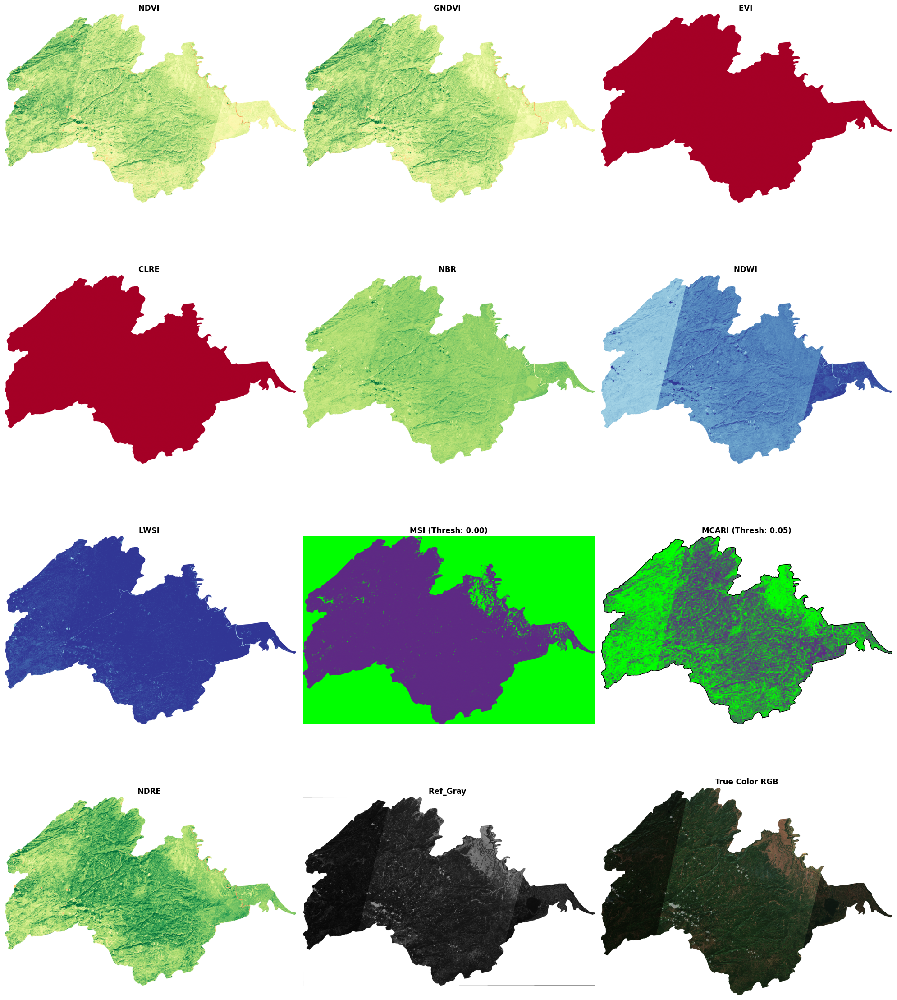

In [2]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import os

# ==========================================
# 1. SETUP FILE PATHS
# ==========================================
master_path = "/content/NDVI,2021.tif"

index_files = {
    "NDVI":  "/content/NDVI,2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "MSI":   "/content/MSI,2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "NDRE":  "/content/NDRE2021.tif",
    "Ref_Gray": "/content/KarbiAnglong2021.tif"
}

rgb_path = "/content/KarbiAnglong2021.tif"

# ==========================================
# 2. ALIGNMENT FUNCTION
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}
    if not os.path.exists(reference_path):
        print("❌ CRITICAL ERROR: Master reference file missing!")
        return {}

    with rasterio.open(reference_path) as ref_src:
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 Master Shape: {ref_shape}")

    for name, path in files.items():
        if not os.path.exists(path):
            print(f"⚠️ Missing: {name}")
            continue

        with rasterio.open(path) as src:
            data = src.read(1)
            # Resize
            if src.shape != ref_shape:
                new_data = np.zeros(ref_shape, dtype=np.float32)
                reproject(source=rasterio.band(src, 1), destination=new_data,
                          src_transform=src.transform, src_crs=src.crs,
                          dst_transform=ref_transform, dst_crs=ref_crs,
                          resampling=Resampling.bilinear)
                data = new_data
            else:
                data = data.astype(np.float32)

            # Fix Scaling (if > 100, divide by 10000)
            if np.nanmax(data) > 100 and name != "Ref_Gray":
                data = data / 10000.0

            # Fix NoData
            data = np.where((data < -100) | (data > 10000), np.nan, data)
            aligned_data[name] = data
            print(f"✅ Loaded: {name:<8}")

    return aligned_data

# ==========================================
# 3. EXECUTE LOADING
# ==========================================
print("⏳ Processing Images...")
final_dataset = align_and_load(index_files, master_path)

# ==========================================
# 4. VISUALIZATION (With Specific Fixes)
# ==========================================
print("\n🎨 Generating 12-Panel Grid...")
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()
fig.patch.set_facecolor('white')

plot_order = ["NDVI", "GNDVI", "EVI", "CLRE", "NBR", "NDWI",
              "LWSI", "MSI", "MCARI", "NDRE", "Ref_Gray"]

for i, name in enumerate(plot_order):
    ax = axes[i]
    ax.set_facecolor('white')

    if name not in final_dataset:
        ax.text(0.5, 0.5, "Missing", ha='center', color='red')
        ax.axis('off'); continue

    data = final_dataset[name]

    # Defaults
    cmap, norm, vmin, vmax = None, None, None, None
    data_plot = data # We might modify this for specific plots

    # ---------------------------------------------------------
    # SPECIAL LOGIC: MSI (Auto-Threshold + Purple/Green)
    # ---------------------------------------------------------
    if name == "MSI":
        # Clip to safe range 0-4
        data_plot = np.clip(data, 0, 4.0)
        auto_threshold = np.nanmedian(data_plot) # Auto-Calc Median

        colors = ['#5e2a84', '#00ff00'] # Purple (Healthy) -> Green (Stressed)
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        title_extra = f"(Thresh: {auto_threshold:.2f})"

    # ---------------------------------------------------------
    # SPECIAL LOGIC: MCARI (Percentile Clip + Green/Purple)
    # ---------------------------------------------------------
    elif name == "MCARI":
        # Robust clipping to remove noise
        p2, p98 = np.nanpercentile(data, [2, 98])
        data_plot = np.clip(data, p2, p98)
        auto_threshold = np.nanmean(data_plot) # Auto-Calc Mean

        colors = ['#00ff00', '#5e2a84'] # Green (Low) -> Purple (High)
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [p2, auto_threshold, p98]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        title_extra = f"(Thresh: {auto_threshold:.2f})"

    # ---------------------------------------------------------
    # SPECIAL LOGIC: EVI (Specific Range)
    # ---------------------------------------------------------
    elif name == "EVI":
        data_plot = np.clip(data, -0.2, 1.0) # Specific Clip
        vmin, vmax = 0, 0.8
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = ""

    # ---------------------------------------------------------
    # SPECIAL LOGIC: CLRE (Specific Range)
    # ---------------------------------------------------------
    elif name == "CLRE":
        data_plot = np.clip(data, 0, 1.5) # Specific Clip
        vmin, vmax = 0, 1.0
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = ""

    # ---------------------------------------------------------
    # STANDARD LOGIC (Everything Else)
    # ---------------------------------------------------------
    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6
        title_extra = ""
    elif name == "Ref_Gray":
        cmap = 'gray'
        title_extra = ""
    else: # NDVI, GNDVI, NBR, NDRE
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        vmin, vmax = -0.5 if name == "NBR" else 0, 1.0
        title_extra = ""

    # PLOT
    data_masked = np.ma.masked_invalid(data_plot)
    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(f"{name} {title_extra}", fontweight='bold', fontsize=12)

    # Add Contour for MSI/MCARI
    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask): ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# ---------------------------------------------------------
# 12TH PANEL: TRUE COLOR RGB
# ---------------------------------------------------------
ax_rgb = axes[11]
ax_rgb.set_facecolor('white')

if os.path.exists(rgb_path):
    with rasterio.open(rgb_path) as src:
        if src.count >= 3:
            r, g, b = src.read(1), src.read(2), src.read(3)
            rgb = np.dstack((r, g, b)).astype(float)

            # Auto-Brightness
            if np.nanmax(rgb) > 255: rgb /= 3000.0
            elif np.nanmax(rgb) > 1: rgb /= 255.0

            rgb = np.clip(rgb, 0, 1)
            ax_rgb.imshow(rgb)
            ax_rgb.set_title("True Color RGB", fontweight='bold', fontsize=12)
        else:
            ax_rgb.text(0.5, 0.5, "Not RGB", ha='center')
else:
    ax_rgb.text(0.5, 0.5, "File Missing", ha='center', color='red')

ax_rgb.axis('off')

plt.tight_layout()
plt.show()

⏳ Processing Images...
🎯 Master Shape: (3144, 4871)
✅ Loaded: NDVI     | Range: 0.18 to 2.00
✅ Loaded: GNDVI    | Range: 0.20 to 2.00
✅ Loaded: EVI      | Range: -99.90 to 3229.44
✅ Loaded: CLRE     | Range: -1.00 to 2.50
✅ Loaded: NBR      | Range: 0.13 to 2.00
✅ Loaded: NDWI     | Range: 0.16 to 2.00
✅ Loaded: LWSI     | Range: 0.22 to 2.00
✅ Loaded: MSI      | Range: 0.00 to 1.59
✅ Loaded: MCARI    | Range: -0.01 to 0.37
✅ Loaded: NDRE     | Range: 0.22 to 2.00

🎨 Generating 12-Panel Grid...


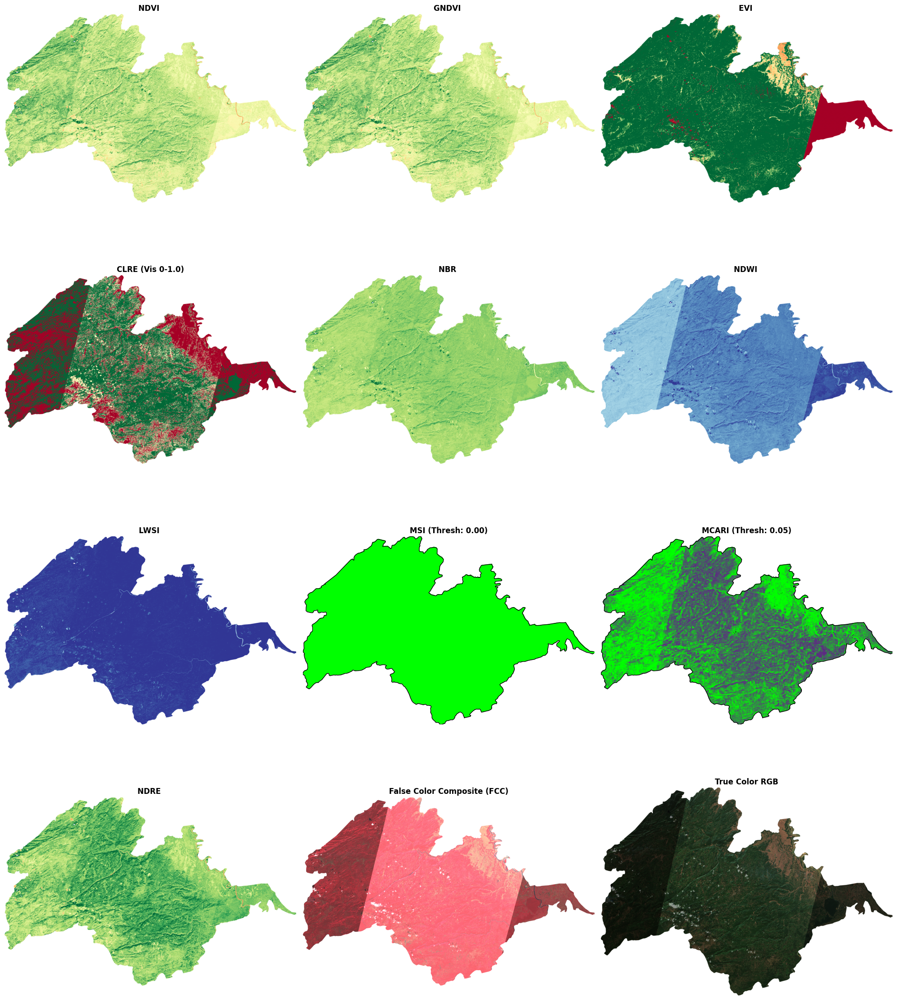

In [1]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import os

# ==========================================
# 1. SETUP FILE PATHS
# ==========================================
master_path = "/content/NDVI,2021.tif"
fcc_path = "/content/FCC,2021.tif"        # NEW: FCC Path
rgb_path = "/content/KarbiAnglong2021.tif" # RGB Path

# Indices to align (Single Band)
index_files = {
    "NDVI":  "/content/NDVI,2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "MSI":   "/content/MSI,2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "NDRE":  "/content/NDRE2021.tif"
}

# ==========================================
# 2. ALIGNMENT FUNCTION (Robust Percentile Scaling)
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}
    if not os.path.exists(reference_path):
        print("❌ CRITICAL ERROR: Master reference file missing!")
        return {}

    with rasterio.open(reference_path) as ref_src:
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 Master Shape: {ref_shape}")

    for name, path in files.items():
        if not os.path.exists(path):
            print(f"⚠️ Missing: {name}")
            continue

        with rasterio.open(path) as src:
            data = src.read(1)

            # 1. Resize if needed
            if src.shape != ref_shape:
                new_data = np.zeros(ref_shape, dtype=np.float32)
                reproject(source=rasterio.band(src, 1), destination=new_data,
                          src_transform=src.transform, src_crs=src.crs,
                          dst_transform=ref_transform, dst_crs=ref_crs,
                          resampling=Resampling.bilinear)
                data = new_data
            else:
                data = data.astype(np.float32)

            # 2. Fix NoData
            data = np.where((data < -100) | (data > 20000), np.nan, data)

            # 3. SMART SCALING (Check 98th Percentile)
            valid_pixels = data[~np.isnan(data)]
            if len(valid_pixels) > 0:
                p98 = np.percentile(valid_pixels, 98)
                if p98 > 100: data = data / 10000.0

            aligned_data[name] = data
            print(f"✅ Loaded: {name:<8} | Range: {np.nanmin(data):.2f} to {np.nanmax(data):.2f}")

    return aligned_data

# ==========================================
# 3. EXECUTE LOADING
# ==========================================
print("⏳ Processing Images...")
final_dataset = align_and_load(index_files, master_path)

# ==========================================
# 4. VISUALIZATION
# ==========================================
print("\n🎨 Generating 12-Panel Grid...")
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()
fig.patch.set_facecolor('white')

# ORDER: 10 Indices + 1 FCC + 1 RGB
plot_order = ["NDVI", "GNDVI", "EVI", "CLRE", "NBR", "NDWI",
              "LWSI", "MSI", "MCARI", "NDRE", "FCC"] # FCC is 11th

for i, name in enumerate(plot_order):
    ax = axes[i]
    ax.set_facecolor('white')

    # ---------------------------------------------------------
    # SPECIAL HANDLER FOR FCC (Load 3 bands directly)
    # ---------------------------------------------------------
    if name == "FCC":
        if os.path.exists(fcc_path):
            with rasterio.open(fcc_path) as src:
                # Read 3 bands
                if src.count >= 3:
                    r, g, b = src.read(1), src.read(2), src.read(3)
                    fcc_img = np.dstack((r, g, b)).astype(float)

                    # Auto-Brightness
                    if np.nanmax(fcc_img) > 255: fcc_img /= 3000.0
                    elif np.nanmax(fcc_img) > 1: fcc_img /= 255.0

                    fcc_img = np.clip(fcc_img, 0, 1)
                    ax.imshow(fcc_img)
                    ax.set_title("False Color Composite (FCC)", fontweight='bold', fontsize=12)
                else:
                    ax.text(0.5, 0.5, "FCC has < 3 Bands", ha='center')
        else:
            ax.text(0.5, 0.5, "FCC File Missing", ha='center', color='red')
        ax.axis('off')
        continue # Skip the rest of the loop for FCC

    # ---------------------------------------------------------
    # STANDARD INDICES HANDLER
    # ---------------------------------------------------------
    if name not in final_dataset:
        ax.text(0.5, 0.5, "Missing", ha='center', color='red')
        ax.axis('off'); continue

    data = final_dataset[name]
    cmap, norm, vmin, vmax = None, None, None, None
    data_plot = data
    title_extra = ""

    if name == "MSI":
        data_plot = np.clip(data, 0, 4.0)
        auto_threshold = np.nanmedian(data_plot)
        colors = ['#5e2a84', '#00ff00'] # Purple->Green
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)
        title_extra = f"(Thresh: {auto_threshold:.2f})"

    elif name == "CLRE":
        data_plot = np.clip(data, 0, 1.5)
        vmin, vmax = 0, 1.0
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = "(Vis 0-1.0)"

    elif name == "EVI":
        data_plot = np.clip(data, -0.2, 1.0)
        vmin, vmax = 0, 0.8
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')

    elif name == "MCARI":
        p2, p98 = np.nanpercentile(data, [2, 98])
        data_plot = np.clip(data, p2, p98)
        auto_threshold = np.nanmean(data_plot)
        colors = ['#00ff00', '#5e2a84'] # Green->Purple
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [p2, auto_threshold, p98]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)
        title_extra = f"(Thresh: {auto_threshold:.2f})"

    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6
    else: # NDVI, GNDVI, NBR, NDRE
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        vmin, vmax = -0.5 if name == "NBR" else 0, 1.0

    data_masked = np.ma.masked_invalid(data_plot)
    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(f"{name} {title_extra}", fontweight='bold', fontsize=12)

    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask): ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# ---------------------------------------------------------
# 12TH PANEL: TRUE COLOR RGB
# ---------------------------------------------------------
ax_rgb = axes[11]
ax_rgb.set_facecolor('white')

if os.path.exists(rgb_path):
    with rasterio.open(rgb_path) as src:
        if src.count >= 3:
            r, g, b = src.read(1), src.read(2), src.read(3)
            rgb = np.dstack((r, g, b)).astype(float)
            if np.nanmax(rgb) > 255: rgb /= 3000.0
            elif np.nanmax(rgb) > 1: rgb /= 255.0
            rgb = np.clip(rgb, 0, 1)
            ax_rgb.imshow(rgb)
            ax_rgb.set_title("True Color RGB", fontweight='bold', fontsize=12)
        else:
            ax_rgb.text(0.5, 0.5, "Not RGB", ha='center')
else:
    ax_rgb.text(0.5, 0.5, "File Missing", ha='center', color='red')

ax_rgb.axis('off')

plt.tight_layout()
plt.show()

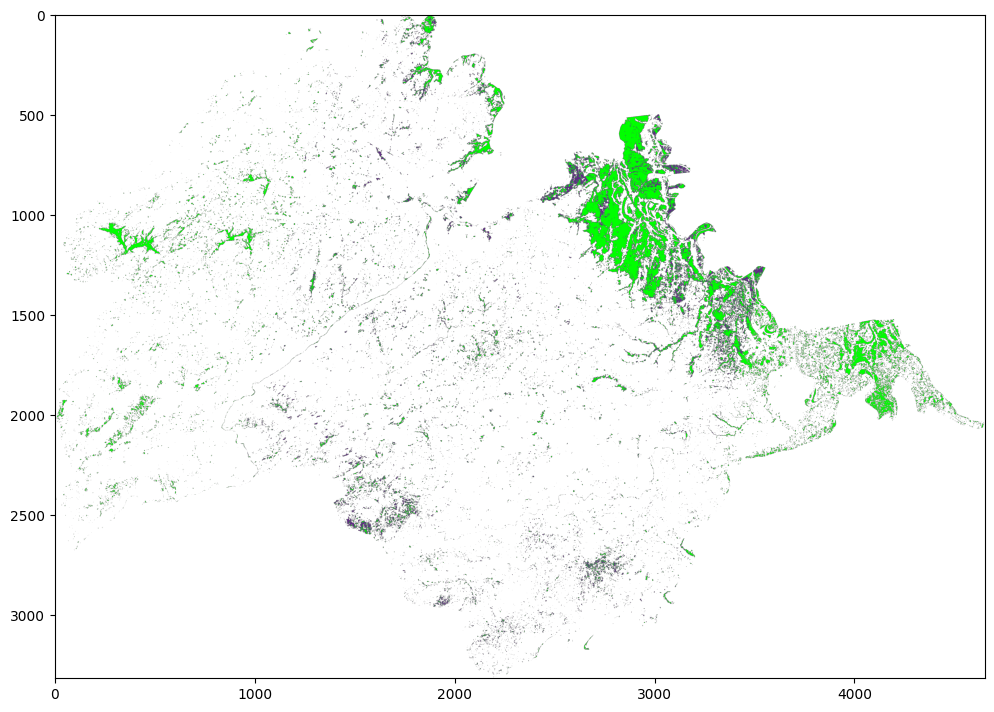

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import numpy as np

# ==========================================
# STEP 4: VISUALIZE THE ALIGNED DATASET
# ==========================================
# We assume 'final_dataset' is available from your previous step

# Setup Grid (4 Rows x 3 Cols)
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()

# Force Global White Background
fig.patch.set_facecolor('white')

print("🎨 Generating Visualization of Aligned Data...")

# We loop through the original file_paths keys to keep the order,
# but we pull the data from 'final_dataset'
for i, name in enumerate(file_paths.keys()):
    ax = axes[i]
    ax.set_facecolor('white') # Force Axis White

    # Check if data exists in our processed dictionary
    if name not in final_dataset:
        ax.text(0.5, 0.5, "Data Not in Dataset", ha='center', color='red')
        ax.axis('off')
        continue

    # Get the cleaned, aligned data
    data = final_dataset[name]

    # Mask NaN values for plotting so they appear white
    data_masked = np.ma.masked_invalid(data)

    # ---------------------------
    # DEFINE STYLING LOGIC
    # ---------------------------
    cmap, norm, vmin, vmax = None, None, None, None

    # 1. STRESS MAPS (Purple/Green)
    if name in ["MSI", "MCARI"]:
        # MSI: Low Value = Healthy (Purple), High Value = Stressed (Green)
        # MCARI: High Value = Healthy (Purple), Low Value = Stressed (Green)

        if name == "MSI":
            colors = ['#5e2a84', '#00ff00'] # Purple -> Green
            threshold = 1.0 # MSI breakpoint
            bounds = [0, threshold, 5]
        else: # MCARI
            colors = ['#00ff00', '#5e2a84'] # Green -> Purple
            threshold = 0.15 # MCARI breakpoint
            bounds = [-1, threshold, 1]

        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

    # 2. WATER MAPS (Blue/Red)
    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6

    # 3. REFERENCE (Karbi)
    elif name == "Ref_Karbi":
        cmap = 'gray' # Because we only read Band 1, we display as Grayscale
        vmin, vmax = 0, 1.0

    # 4. VEGETATION MAPS (Red/Green)
    else:
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')

        # Specific Ranges for best contrast
        if name == "EVI": vmin, vmax = 0, 0.8
        elif name == "CLRE": vmin, vmax = 0, 1.5
        elif name == "NBR": vmin, vmax = -0.5, 0.8
        else: vmin, vmax = 0, 1.0 # Standard NDVI/GNDVI

    # ---------------------------
    # PLOT
    # ---------------------------
    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(name, fontweight='bold', fontsize=12)

    # Add Contour Border for discrete stress maps
    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask):
            ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# Hide the 12th empty slot if we have 11 images
if len(file_paths) < 12:
    axes[11].axis('off')

plt.tight_layout()
plt.show()
# ==========================================
# 1. LOAD THE MSI DATA
# ==========================================
# Make sure this path matches your uploaded file exactly
file_path = "/content/MSI,2021.tif"

with rasterio.open(file_path) as src:
    msi_data = src.read(1)
    # Mask out NoData values (usually 0 or huge numbers) so they don't affect plotting
    msi_masked = np.ma.masked_where((msi_data == 0) | (msi_data > 10), msi_data)

# ==========================================
# 2. DEFINE CUSTOM COLORS LIKE THE IMAGE
# ==========================================
# The image has just two main colors. Let's define them precisely.
# Purple for low values (healthy), Green for high values (stressed).
colors = ['#5e2a84', '#00ff00'] # A deep purple and a bright green
cmap_custom = mcolors.ListedColormap(colors)

# DEFINE THE THRESHOLD
# This is the critical part. Where does "Purple" stop and "Green" begin?
# Based on MSI science, ~1.0 is a good cutoff for "stress".
# Values 0 to 1.0 will be Purple. Values > 1.0 will be Green.
bounds = [0.0, 1.0, 6.0] # 6.0 is just an upper limit to catch everything else
norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

# ==========================================
# 3. SETUP THE PLOT WITH BORDER
# ==========================================
fig, ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor('white') # Set background to white

# PLOT THE RASTER
# Use our custom two-color map and threshold norm
im = ax.imshow(msi_masked, cmap=cmap_custom, norm=norm)

# CREATE THE BLACK BORDER
# 1. Make a simple mask: 1 where there is data, 0 where it